<a href="https://colab.research.google.com/github/JoeKomo/Machine-Learning/blob/main/Stock_Market_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set()
import plotly.express as px
import plotly.graph_objects as go
from pandas.plotting import scatter_matrix
from datetime import datetime
import warnings
warnings.filterwarnings("ignore")
sns.set_style('dark')
plt.rcParams['font.size'] = 20
plt.rcParams['figure.figsize'] = (22, 8)
plt.rcParams['figure.facecolor'] = '#00000000'
plt.rcParams['lines.linewidth'] = 2
import plotly.graph_objects as go
from pandas.plotting import scatter_matrix
from datetime import datetime

In [2]:
from google.colab import files
upload = files.upload() 

Saving prices-split-adjusted.csv to prices-split-adjusted.csv


In [3]:
df = pd.read_csv("prices-split-adjusted.csv", parse_dates=['date'])

In [4]:
df

,date,symbol,open,close,low,high,volume
0,2016-01-05,WLTW,123.430000,125.839996,122.309998,126.250000,2163600.0
1,2016-01-06,WLTW,125.239998,119.980003,119.940002,125.540001,2386400.0
2,2016-01-07,WLTW,116.379997,114.949997,114.930000,119.739998,2489500.0
3,2016-01-08,WLTW,115.480003,116.620003,113.500000,117.440002,2006300.0
4,2016-01-11,WLTW,117.010002,114.970001,114.089996,117.330002,1408600.0
...,...,...,...,...,...,...,...
851259,2016-12-30,ZBH,103.309998,103.199997,102.849998,103.930000,973800.0
851260,2016-12-30,ZION,43.070000,43.040001,42.689999,43.310001,1938100.0
851261,2016-12-30,ZTS,53.639999,53.529999,53.270000,53.740002,1701200.0
851262,2016-12-30,AIV,44.730000,45.450001,44.410000,45.590000,1380900.0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 851264 entries, 0 to 851263
Data columns (total 7 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    851264 non-null  datetime64[ns]
 1   symbol  851264 non-null  object        
 2   open    851264 non-null  float64       
 3   close   851264 non-null  float64       
 4   low     851264 non-null  float64       
 5   high    851264 non-null  float64       
 6   volume  851264 non-null  float64       
dtypes: datetime64[ns](1), float64(5), object(1)
memory usage: 45.5+ MB


In [7]:
df["date"] = pd.to_datetime(df["date"])

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 851264 entries, 0 to 851263
Data columns (total 7 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    851264 non-null  datetime64[ns]
 1   symbol  851264 non-null  object        
 2   open    851264 non-null  float64       
 3   close   851264 non-null  float64       
 4   low     851264 non-null  float64       
 5   high    851264 non-null  float64       
 6   volume  851264 non-null  float64       
dtypes: datetime64[ns](1), float64(5), object(1)
memory usage: 45.5+ MB


In [9]:
df.isnull().sum()

date      0
symbol    0
open      0
close     0
low       0
high      0
volume    0
dtype: int64

In [10]:
#Bringing out the companies to work on

amazon = df[df["symbol"]=="AMZN"]
apple= df[df['symbol']=="AAPL"]
microsoft = df[df["symbol"]=="MSFT"]

### These three were chosen based on there trading volumes in Information and Technology Sector.

# Amazon Stock Analysis

In [11]:
amazon.head(4)

,date,symbol,open,close,low,high,volume
284,2010-01-04,AMZN,136.250000,133.899994,133.139999,136.610001,7599900.0
751,2010-01-05,AMZN,133.429993,134.690002,131.809998,135.479996,8851900.0
1219,2010-01-06,AMZN,134.600006,132.250000,131.649994,134.729996,7178800.0
1687,2010-01-07,AMZN,132.009995,130.000000,128.800003,132.320007,11030200.0


In [12]:
fig = px.line(amazon, x="date", y=["open",  'close'], title="Differences between open and close prices of Amazon" )
fig.update_xaxes(rangeslider_visible=True)
fig.show()

## The chart above is the plot of open and close prices against time. The chart shows an upward trend movement of price from 2011 to 2016. There is a significant downward reversal between december 2015 and Feb 2016.¶

In [13]:
fig = px.line(amazon, x="date", y=["high", "low"], title="Differences between high and low prices of Amazon")
fig.update_xaxes(rangeslider_visible=True)
fig.show('notebook')

### Just like the open and close prices, the high and low prices have an upward trend from mid 2010 to 2017

In [14]:
fig = px.line(amazon, x="date", y="volume", title="Volume Traded by Amazon")
fig.show('notebook')

#### Trading Volume determines Liquidity and market strenght, Exhaustion move etc.

In [15]:
amazon['volume'].argmax()

139

In [16]:
amazon.iloc[amazon['volume'].argmax()]

date      2010-07-23 00:00:00
symbol                   AMZN
open                   105.93
close              118.870003
low                105.800003
high               119.279999
volume             42421100.0
Name: 65395, dtype: object

### There is an unusual spike in the volume of Amazon on the 23rd of July, 2010. 

# Bolinger Band for Amazon

Bollinger bands are use to determine overbought and oversold. its indicator focuses on price and volatility.

Bolinger Band = MA +/- 2*std 

MA = Moving Average

std = Standard Deviation

TP = Target Price

Bolinger Band = MA +/- 2*std .

BOLU = bolinger upper part = MA + 2*std

BOLD = bolinger lower part = MA - 2*std

In [17]:
amazon['TP'] = (df["close"] +df["low"] + df["high"])/3
amazon['std'] = amazon['TP'].rolling(20).std(ddof=0)
amazon["MA-TP"] = amazon["TP"].rolling(20).mean()
amazon["BOLU"] = amazon["MA-TP"]+2*amazon["std"]
amazon['BOLD'] = amazon["MA-TP"] - 2*amazon['std']

In [18]:
amazon

,date,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD
284,2010-01-04,AMZN,136.250000,133.899994,133.139999,136.610001,7599900.0,134.549998,NaN,NaN,NaN,NaN
751,2010-01-05,AMZN,133.429993,134.690002,131.809998,135.479996,8851900.0,133.993332,NaN,NaN,NaN,NaN
1219,2010-01-06,AMZN,134.600006,132.250000,131.649994,134.729996,7178800.0,132.876663,NaN,NaN,NaN,NaN
1687,2010-01-07,AMZN,132.009995,130.000000,128.800003,132.320007,11030200.0,130.373337,NaN,NaN,NaN,NaN
2155,2010-01-08,AMZN,130.559998,133.520004,129.029999,133.679993,9830500.0,132.076665,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
848799,2016-12-23,AMZN,764.549988,760.590027,757.989990,766.500000,1976900.0,761.693339,8.065244,762.891169,779.021657,746.760682
849299,2016-12-27,AMZN,763.400024,771.400024,761.200012,774.650024,2627400.0,769.083353,8.055304,762.878503,778.989112,746.767894
849799,2016-12-28,AMZN,776.250000,772.130005,770.500000,780.000000,3279100.0,774.210002,8.422107,763.360169,780.204383,746.515956
850299,2016-12-29,AMZN,772.400024,765.150024,760.849976,773.400024,3153500.0,766.466675,8.286509,763.868336,780.441353,747.295319


In [19]:
amazon.isnull().sum()

date       0
symbol     0
open       0
close      0
low        0
high       0
volume     0
TP         0
std       19
MA-TP     19
BOLU      19
BOLD      19
dtype: int64

#### The Std, BOLD,BOLU and MA_TP all have 19 Null value because of the 20 moving average

In [20]:
amazon = amazon.set_index("date")

<Figure size 1440x1440 with 0 Axes>

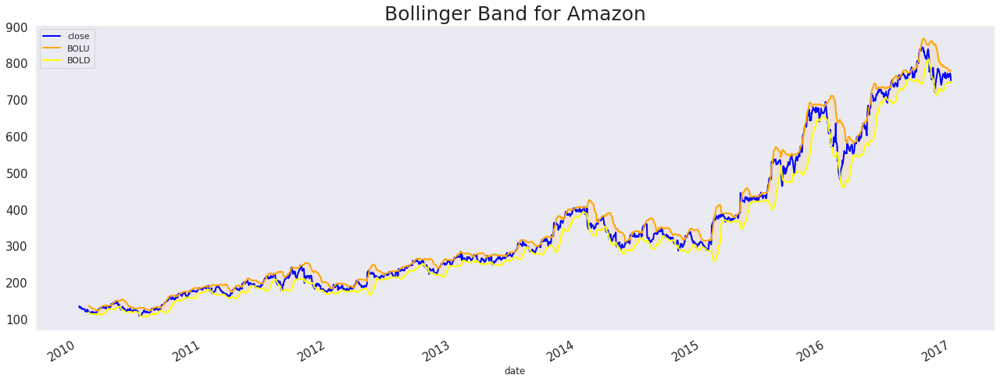

In [21]:
plt.figure(figsize=(20,20))
ax=amazon[["close", "BOLU", 'BOLD']].plot(color=['blue', 'orange', 'yellow'], fontsize = 15)
ax.fill_between(amazon.index, amazon["BOLD"], amazon["BOLU"], facecolor='orange', alpha=0.1)
plt.title("Bollinger Band for Amazon", fontsize = 25)
plt.show()

#### The Bolinger Band can be used to determine the volatility of an asset as well as identifying the trend using overbought and oversold strategy. The tightness of the Bollinger band shows that the asset is less volatile because the tightness of Bollinger is inversely proportional to Volatility.¶

In [22]:
amazon_new = amazon[amazon.index >= datetime(2016,1,1)]

In [23]:
amazon_new.head()

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD
date,,,,,,,,,,,
2016-01-04,AMZN,656.289978,636.989990,627.510010,657.719971,9314500.0,640.739990,11.928722,666.938170,690.795615,643.080726
2016-01-05,AMZN,646.859985,633.789978,627.650024,646.909973,5822600.0,636.116658,13.661357,665.263669,692.586384,637.940954
2016-01-06,AMZN,622.000000,632.650024,620.309998,639.789978,5329200.0,630.916667,15.540708,663.379668,694.461084,632.298252
2016-01-07,AMZN,621.799988,607.940002,605.210022,630.000000,7074900.0,614.383341,18.684169,660.480336,697.848674,623.111997
2016-01-08,AMZN,619.659973,607.049988,606.000000,624.140015,5512900.0,612.396668,21.344299,657.775669,700.464268,615.087070


<Figure size 1440x1440 with 0 Axes>

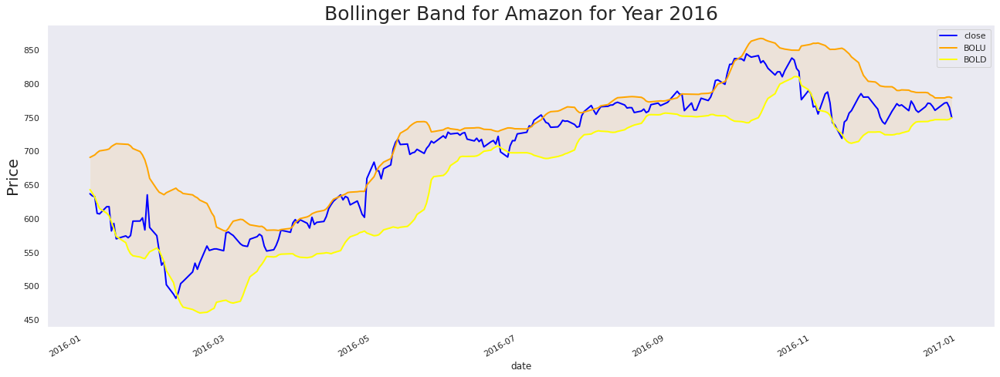

In [24]:
#For better visual
plt.figure(figsize=(20,20))
ax=amazon_new[["close", "BOLU", 'BOLD']].plot(color=['blue', 'orange', 'yellow'])
ax.fill_between(amazon_new.index, amazon_new["BOLD"], amazon_new["BOLU"], facecolor='orange', alpha=0.1)
plt.title("Bollinger Band for Amazon for Year 2016", fontsize = 25)
plt.ylabel("Price", fontsize = 20)
plt.show()

## INSIGTH
##### Amazon has a very tight Bollinger which shows that the market was less volatile i.e stable market. The Chart above shows the bollinger band of amazon for the year 2016. The has a better visual so as to be able to visualize the point of bounce and pullback. The price of asset breaking below the lower band around late of 2016-02 indicates oversold which was responsible for the bounce. On the other hand a point, a point arround may shows a pullback when the price crosses the upper band.

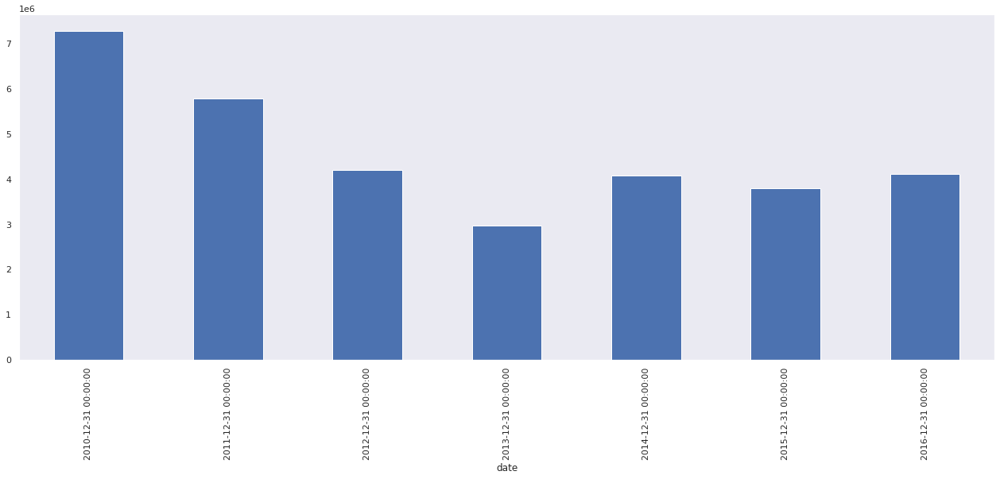

In [25]:
amazon['volume'].resample("Y").mean().plot.bar()

## INSIGHT
### As Volume is viewed as an indicator of liquidity, the downward trend of traded volume over the course of years shows that the ease of converting the asset into ready cash without affecting its market price is reducing


####  Don't forget we had an upward trend in price. So, upward trend in price while there is downward trend in volume indicates that the investors are choosing to invest at the current pricing level.

# Apple Stock Analysis

In [26]:
apple.head(5)

,date,symbol,open,close,low,high,volume
254,2010-01-04,AAPL,30.490000,30.572857,30.340000,30.642857,123432400.0
721,2010-01-05,AAPL,30.657143,30.625713,30.464285,30.798571,150476200.0
1189,2010-01-06,AAPL,30.625713,30.138571,30.107143,30.747143,138040000.0
1657,2010-01-07,AAPL,30.250000,30.082857,29.864286,30.285715,119282800.0
2125,2010-01-08,AAPL,30.042856,30.282858,29.865715,30.285715,111902700.0


In [27]:
fig= px.line(apple, x="date", y=["open", 'high', 'low', 'close'], title="Apple Stock Prices ")
fig.show("notebook")

### On overrall over the years, the chart shows an upward trend in the movement of price. Although bthe movement is not perfect as there was an aggressive downward trend from September 2012 to April 2013. Also it can be deduced that the market made an unusual low arround August, 2015 considering the movement of Price before then and since then, the market has been on consolidation. 

In [28]:
fig = px.line(apple, x="date", y="volume", title= "Apple Trading Apple Volume")
fig.show("notebook")

In [29]:
apple['volume'].argmin()

1737

In [30]:
apple.iloc[apple['volume'].argmin()]

date      2016-11-25 00:00:00
symbol                   AAPL
open               111.129997
close              111.790001
low                110.949997
high               111.870003
volume             11475900.0
Name: 838767, dtype: object

Apple has it lowest volume at December 25, 2016.

# Bollinger Band for apple

In [31]:
apple = apple.set_index("date")

In [32]:
apple["TP"] = (apple["close"] + apple['high'] + apple ["low"])/3
apple['std'] = apple['TP'].rolling(20).std(ddof=0)
apple["MA-TP"] = apple["TP"].rolling(20).mean()
apple["BOLU"]= apple["MA-TP"] + 2*apple["std"]
apple["BOLD"] = apple["MA-TP"] - 2*apple['std']

<Figure size 1440x1440 with 0 Axes>

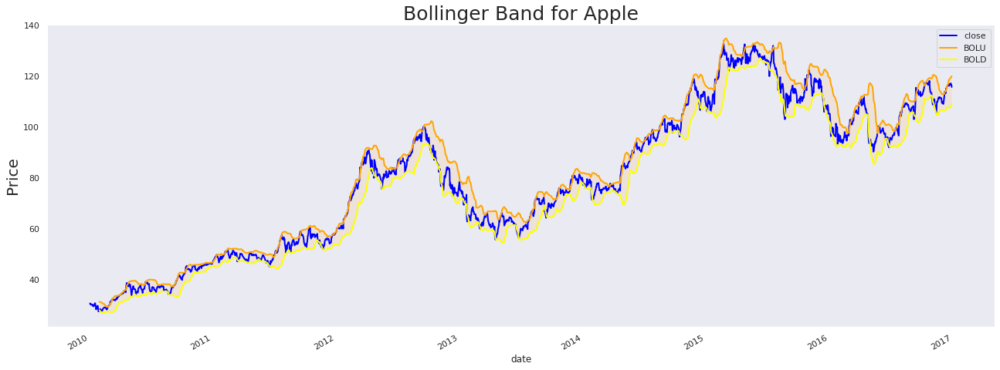

In [33]:
plt.figure(figsize=(20,20))
ax=apple[["close", "BOLU", "BOLD"]].plot(color=['blue', 'orange', 'yellow'])
ax.fill_between(apple.index, apple["BOLD"], apple["BOLU"], facecolor = "orange", alpha=0.1)
plt.title("Bollinger Band for Apple", fontsize = 25)
plt.ylabel("Price", fontsize = 20)
plt.show()

### The Bollinger Band is not too tight and this indicates high volatility.

In [34]:
apple_new = apple[apple.index >= datetime(2016,1,1)]

<Figure size 1440x1440 with 0 Axes>

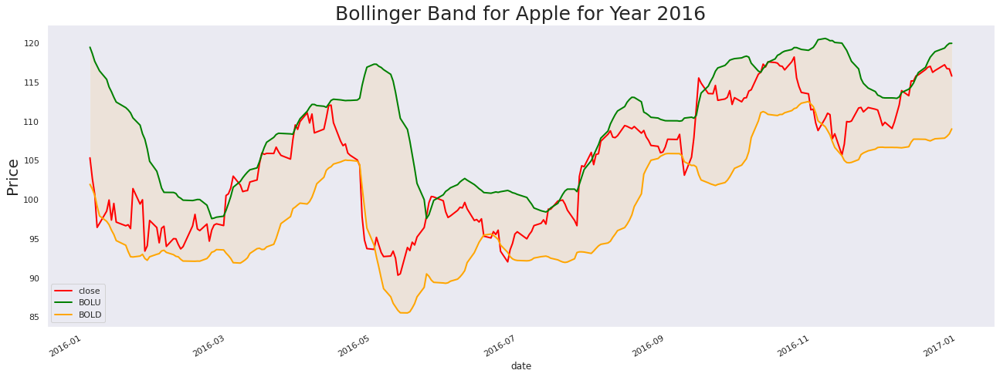

In [35]:
plt.figure(figsize=(20,20))
ax=apple_new[["close", "BOLU", 'BOLD']].plot(color=['red', 'green', 'orange'])
ax.fill_between(apple_new.index, apple_new["BOLD"], apple_new["BOLU"], facecolor='orange', alpha=0.1)
plt.title("Bollinger Band for Apple for Year 2016", fontsize = 25)
plt.ylabel("Price", fontsize = 20)
plt.show()


### The Chart above shows the bollinger band of Apple for the year 2016. The has a better visual so as to be able to visualize the point of bounce and pullback. The price of asset breaking below the lower band around late of 2016-05 indicates oversold which was responsible for the bounce. On the other hand a point, a point arround June shows a pullback when the price crosses the upper band.

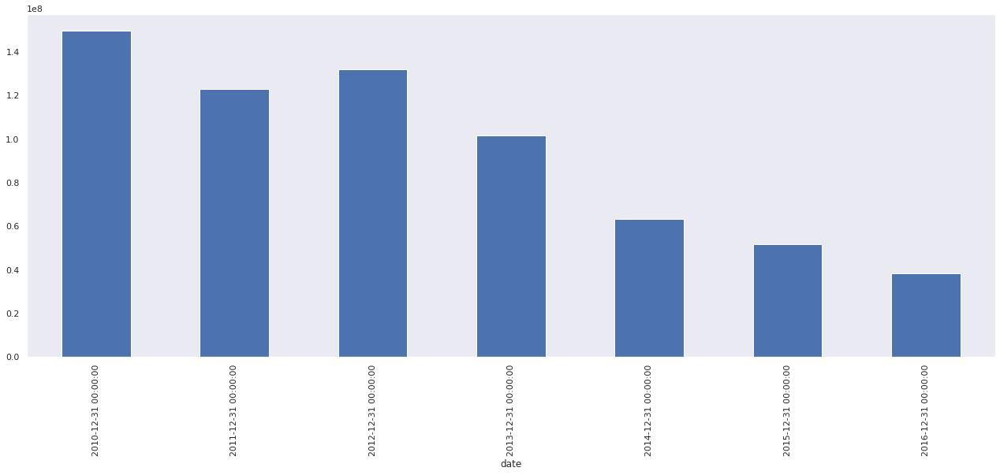

In [36]:
apple['volume'].resample("Y").mean().plot.bar()

### INSIGHT

There is a downward Trend in the volume over the years.

# Microsoft 

In [37]:
microsoft.head()

,date,symbol,open,close,low,high,volume
544,2010-01-04,MSFT,30.620001,30.950001,30.590000,31.100000,38409100.0
1012,2010-01-05,MSFT,30.850000,30.959999,30.639999,31.100000,49749600.0
1480,2010-01-06,MSFT,30.879999,30.770000,30.520000,31.080000,58182400.0
1948,2010-01-07,MSFT,30.629999,30.450001,30.190001,30.700001,50559700.0
2416,2010-01-08,MSFT,30.280001,30.660000,30.240000,30.879999,51197400.0


In [38]:
fig= px.line(microsoft, x="date", y=["open", 'high', 'low', 'close'], title="Microsoft Stock Prices")
fig.show("notebook")

## INSIGHT

There was a downward trend in price for Microsoft stock from January to July, 2010. The Market has been in consolidation since then until around Jan, 2013 when the significant upward trend started.

In [39]:
fig = px.line(microsoft, x="date", y="volume", title= " Microsoft Trading volume")
fig.show("notebook")

## Bollinger Band for Microsoft

In [40]:
microsoft = microsoft.set_index("date")

In [41]:
microsoft["TP"] = (microsoft["close"] + microsoft['high'] + microsoft["low"])/3
microsoft['std'] = microsoft['TP'].rolling(20).std(ddof=0)
microsoft["MA-TP"] = microsoft["TP"].rolling(20).mean()
microsoft["BOLU"]= microsoft["MA-TP"] + 2*microsoft["std"]
microsoft["BOLD"] = microsoft["MA-TP"] - 2*microsoft['std']

<Figure size 1440x1440 with 0 Axes>

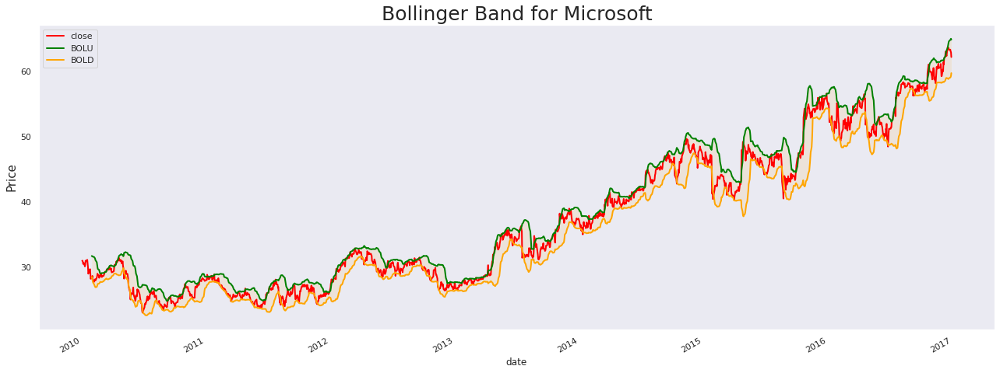

In [42]:
plt.figure(figsize=(20,20))
ax=microsoft[["close", "BOLU", "BOLD"]].plot(color=['red', "green", "orange"])
ax.fill_between(microsoft.index, microsoft["BOLD"], microsoft["BOLU"], facecolor = "orange", alpha=0.1)
plt.title("Bollinger Band for Microsoft", fontsize = 25)
plt.ylabel('Price', fontsize = 15)
plt.show()

In [43]:
microsoft_new = microsoft[microsoft.index >= datetime(2016,1,1)]

<Figure size 1440x1440 with 0 Axes>

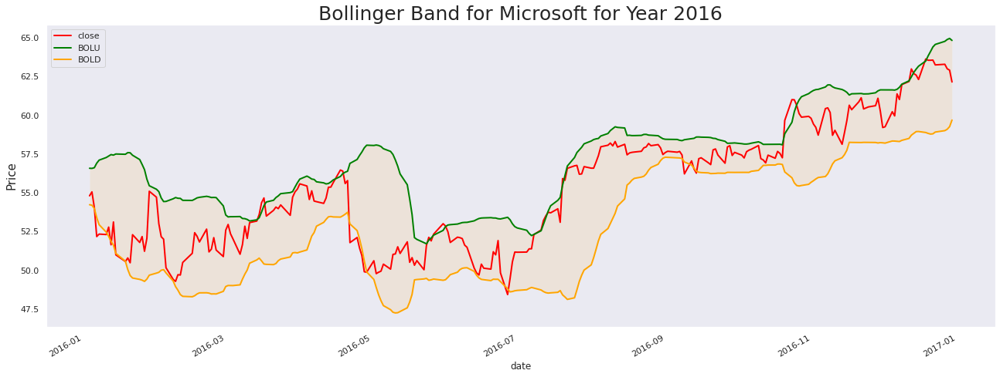

In [44]:
plt.figure(figsize=(20,20))
ax=microsoft_new[["close", "BOLU", 'BOLD']].plot(color=['red', 'green', 'orange'])
ax.fill_between(microsoft_new.index, microsoft_new["BOLD"], microsoft_new["BOLU"], facecolor='orange', alpha=0.1)
plt.title("Bollinger Band for Microsoft for Year 2016", fontsize = 25)
plt.ylabel('Price', fontsize = 15)
plt.show()

### Microsoft has a narrow Bollinger which shows volatility of the asset. The Chart above shows the bollinger band of Microsoft for the year 2016. This has a better visual so as to be able to visualize the point of bounce and pullback. The price of asset breaking above the Upperband around 2016-05 indicates a point of overbought which was technically responsible for the pullback afterward. On the other hand a point, a point arround July shows a bounce when the price crosses the lower band.

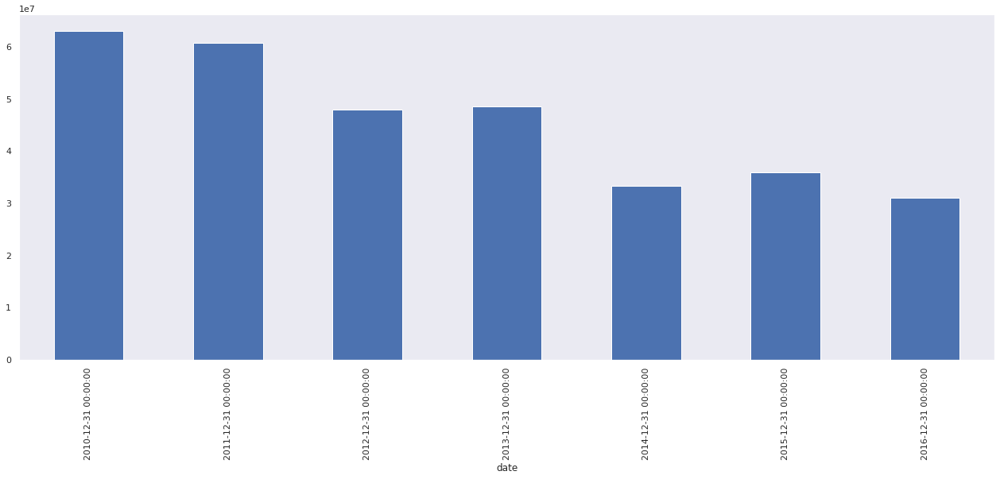

In [45]:
microsoft['volume'].resample("Y").mean().plot.bar()

# Comparison between Apple, Amazon, and Microsoft


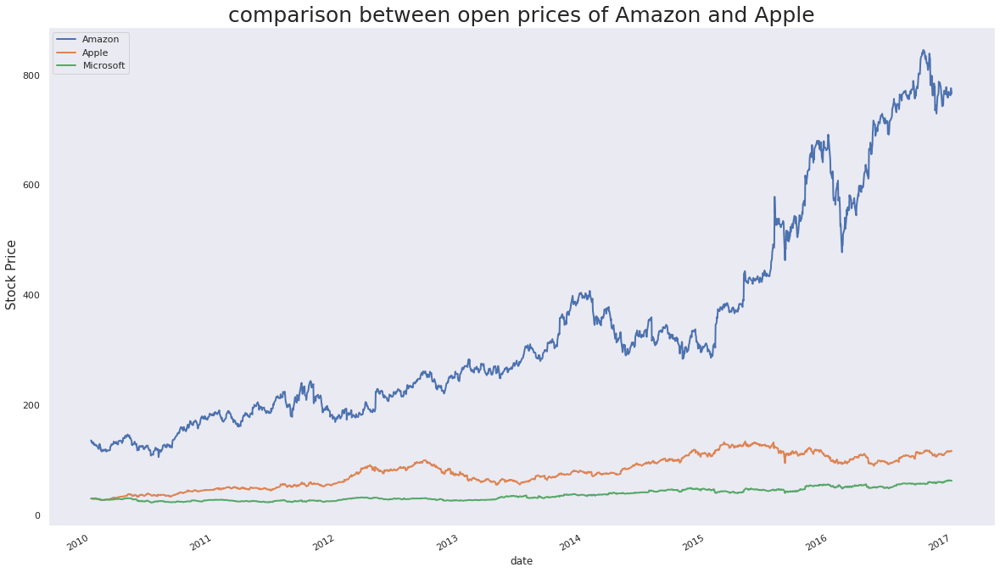

In [46]:
plt.figure(figsize=(20, 12))
amazon['open'].plot(label="Amazon")
apple['open'].plot(label="Apple")
microsoft['open'].plot(label="Microsoft")
plt.title("comparison between open prices of Amazon and Apple", fontsize = 25)
plt.ylabel(' Stock Price', fontsize = 15)
plt.legend()
plt.show()

### Amazon shows a good upward trend of Prices and Price volatility over the years compare to both Apple and Microsoft and also Amazon stock price is higher than the other two.

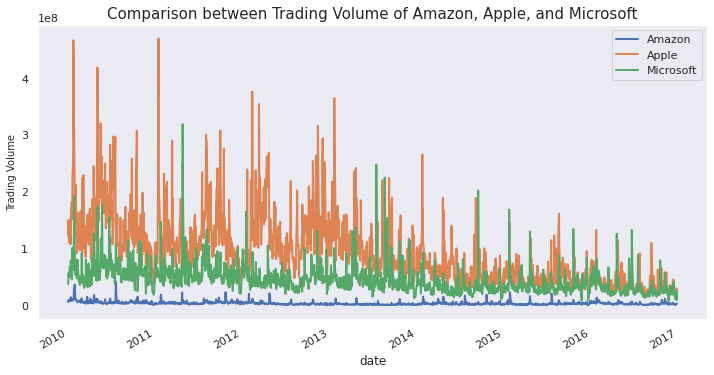

In [47]:
plt.figure(figsize=(12,6))
amazon['volume'].plot(label="Amazon")
apple["volume"].plot(label="Apple")
microsoft["volume"].plot(label="Microsoft")
plt.legend()
plt.title("Comparison between Trading Volume of Amazon, Apple, and Microsoft", fontsize = 15)
plt.ylabel('Trading Volume', fontsize = 10)
plt.show()

### Contrary to the price action, Apple performs the best in terms of Amount of trading volume but it has an obvious downward trend in the trading volume compare to others. 

# Market Cap for the companies

#### Market cap can give an insight to the asset traded more as it takes two factors into account both the price and volume traded.

In [48]:
amazon["Total Traded"] = amazon["open"] * amazon["volume"]
apple["Total Traded"] = apple["open"] * apple["volume"]
microsoft["Total Traded"] = microsoft["open"] * microsoft["volume"]

In [49]:
amazon.sample(3)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded
date,,,,,,,,,,,,
2013-05-10,AMZN,260.880005,263.630005,260.209991,263.649994,3145300.0,262.496663,6.948688,260.871665,274.769042,246.974289,8.205459e+08
2011-06-15,AMZN,188.039993,185.979996,185.300003,192.449997,6317700.0,187.909999,3.879623,192.069667,199.828913,184.310421,1.187980e+09
2010-10-15,AMZN,158.419998,164.639999,156.750000,164.880005,10135500.0,162.090001,3.106060,155.920500,162.132620,149.708379,1.605666e+09


In [50]:
apple.sample(3)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded
date,,,,,,,,,,,,
2015-10-06,AAPL,110.629997,111.309998,109.769997,111.739998,48196800.0,110.939998,2.208467,112.853500,117.270434,108.436567,5.332012e+09
2015-09-09,AAPL,113.760002,110.150002,109.769997,114.019997,85010800.0,111.313332,3.731096,111.548333,119.010525,104.086141,9.670829e+09
2010-01-05,AAPL,30.657143,30.625713,30.464285,30.798571,150476200.0,30.629523,NaN,NaN,NaN,NaN,4.613170e+09


In [51]:
microsoft.sample(3)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded
date,,,,,,,,,,,,
2016-07-20,MSFT,56.150002,55.910000,55.529999,56.840000,89893300.0,56.093333,1.769404,51.947834,55.486642,48.409025,5.047509e+09
2010-06-30,MSFT,23.299999,23.010000,22.950001,23.680000,81050500.0,23.213334,0.931827,25.414500,27.278154,23.550846,1.888477e+09
2014-05-22,MSFT,40.290001,40.099998,39.849998,40.349998,20201800.0,40.099998,0.435184,39.910666,40.781034,39.040298,8.139305e+08


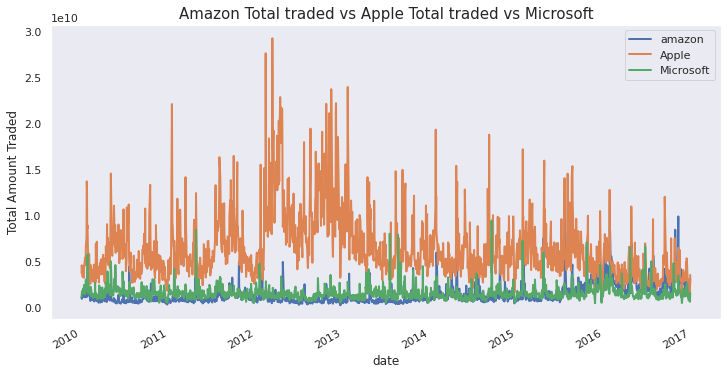

In [52]:
plt.figure(figsize=(12,6))
amazon["Total Traded"].plot(label='amazon')
apple['Total Traded'].plot(label="Apple")
microsoft['Total Traded'].plot(label="Microsoft")
plt.ylabel("Total Amount Traded")
plt.legend()
plt.title("Amazon Total traded vs Apple Total traded vs Microsoft", fontsize = 15)
plt.show()

### As we can see Apple is traded on the higher side compare to the other two. 

The lines of code below  extract the date of usual upward spike in the total traded of the three companies

In [53]:
apple['Total Traded'].argmax()

553

In [54]:
apple.iloc[[apple['Total Traded'].argmax()]]

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded
date,,,,,,,,,,,,
2012-03-14,AAPL,82.578575,84.225716,82.199997,84.959999,354711000.0,83.795237,3.015962,75.945714,81.977639,69.91379,2.929153e+10


In [55]:
microsoft["Total Traded"].argmax()

1186

In [56]:
microsoft.iloc[microsoft["Total Traded"].argmax()]

symbol                     MSFT
open                  46.810001
close                     47.52
low                   46.599998
high                      47.57
volume              202522400.0
TP                    47.229999
std                    0.810606
MA-TP                   45.9005
BOLU                  47.521712
BOLD                  44.279287
Total Traded    9480073746.5224
Name: 2014-09-19 00:00:00, dtype: object

In [57]:
amazon["Total Traded"].argmax()

1398

In [58]:
amazon.iloc[amazon["Total Traded"].argmax()]

symbol                     AMZN
open                  578.98999
close                529.419983
low                  529.349976
high                 580.570007
volume               21909400.0
TP                   546.446655
std                   29.163546
MA-TP                459.270501
BOLU                 517.597593
BOLD                 400.943409
Total Traded    12685323286.906
Name: 2015-07-24 00:00:00, dtype: object

# Moving Average

In [59]:
amazon['MA-50'] = amazon['close'].rolling(50).mean()
apple["MA-50"] = apple['close'].rolling(50).mean()
microsoft["MA-50"] = microsoft['close'].rolling(50).mean()

In [60]:
amazon['MA-20'] = amazon['close'].rolling(20).mean()
apple["MA-20"] = apple['close'].rolling(20).mean()
microsoft["MA-20"] = microsoft['close'].rolling(20).mean()

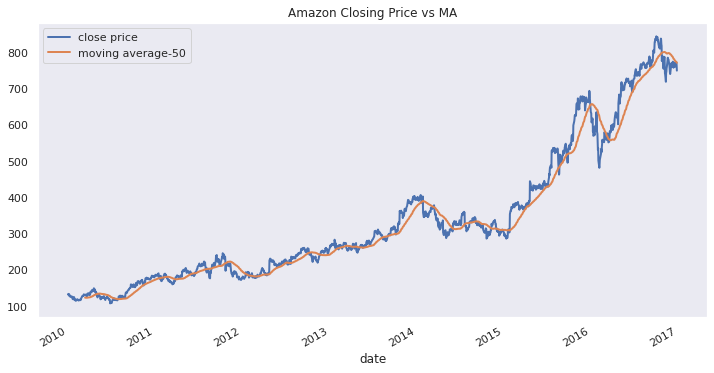

In [61]:
plt.figure(figsize=(12,6))
amazon['close'].plot(label="close price")
amazon['MA-50'].plot(label="moving average-50")
plt.legend()
plt.title("Amazon Closing Price vs MA")
plt.show()

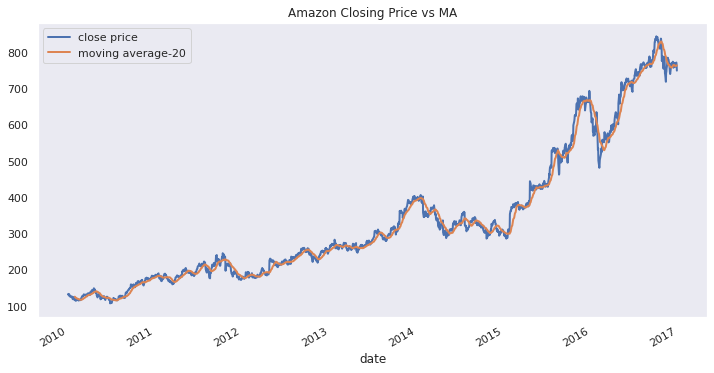

In [62]:
plt.figure(figsize=(12,6))
amazon['close'].plot(label="close price")
amazon['MA-20'].plot(label="moving average-20")
plt.legend()
plt.title("Amazon Closing Price vs MA")
plt.show()

APPLE

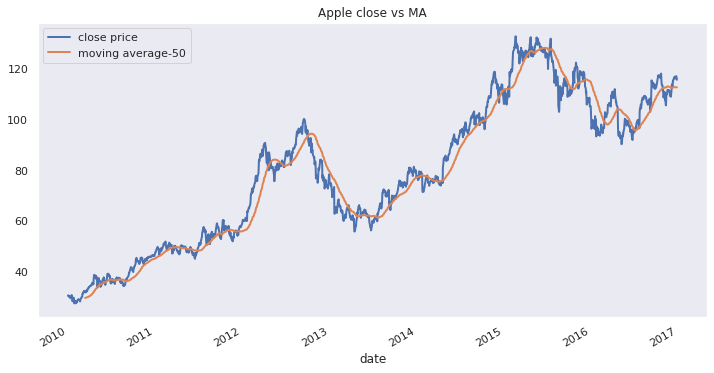

In [63]:
plt.figure(figsize=(12,6))
apple['close'].plot(label="close price")
apple['MA-50'].plot(label="moving average-50")
plt.title("Apple close vs MA")
plt.legend()
plt.show()

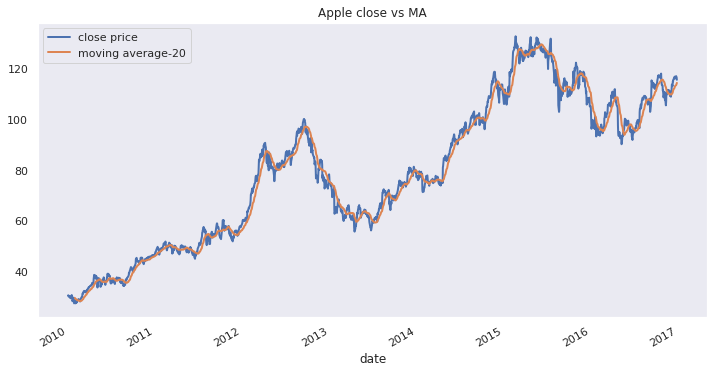

In [64]:
plt.figure(figsize=(12,6))
apple['close'].plot(label="close price")
apple['MA-20'].plot(label="moving average-20")
plt.title("Apple close vs MA")
plt.legend()
plt.show()


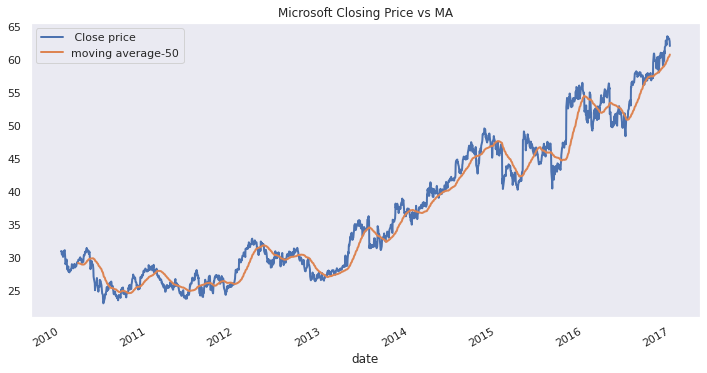

In [65]:
plt.figure(figsize=(12,6))
microsoft['close'].plot(label=" Close price")
microsoft['MA-50'].plot(label="moving average-50")
plt.title("Microsoft Closing Price vs MA")
plt.legend()
plt.show()

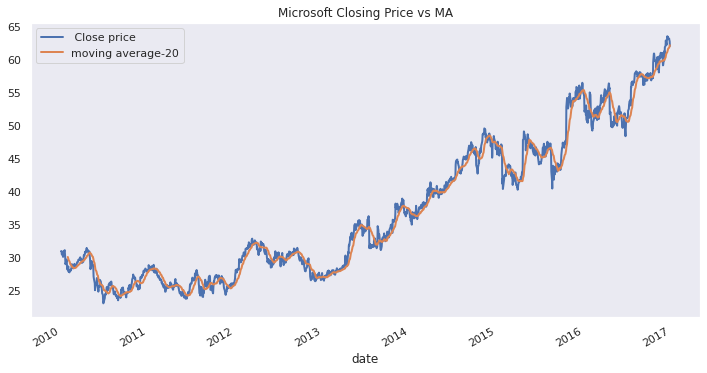

In [66]:
plt.figure(figsize=(12,6))
microsoft['close'].plot(label=" Close price")
microsoft['MA-20'].plot(label="moving average-20")
plt.title("Microsoft Closing Price vs MA")
plt.legend()
plt.show()


##### The moving Averages smoothing the lines so as to better visualize the movement of the trends.

## Using the cross over SMA strategy to predict the sell and buy signal

In [67]:
amazon['Signal'] = 0.0
amazon['Signal'] = np.where(amazon['MA-20'] > amazon['MA-50'], 1.0, 0.0)

In [68]:
amazon.sample(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal
date,,,,,,,,,,,,,,,
2015-08-25,AMZN,487.489990,466.369995,466.250000,489.440002,5679300.0,474.019999,19.808670,522.976502,562.593843,483.359161,2.768602e+09,483.279404,521.981505,1.0
2014-06-02,AMZN,312.589996,308.839996,307.000000,312.600006,2203400.0,309.480001,7.210868,302.448335,316.870071,288.026599,6.887608e+08,316.981199,302.748500,0.0
2013-05-10,AMZN,260.880005,263.630005,260.209991,263.649994,3145300.0,262.496663,6.948688,260.871665,274.769042,246.974289,8.205459e+08,263.150199,260.812000,0.0
2013-02-04,AMZN,262.779999,259.980011,259.070007,264.679993,3723600.0,261.243337,4.587074,269.682500,278.856647,260.508352,9.784876e+08,258.653400,269.300500,1.0


In [69]:
amazon['Position'] = amazon['Signal'].diff()
amazon.head(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position
date,,,,,,,,,,,,,,,,
2010-01-04,AMZN,136.250000,133.899994,133.139999,136.610001,7599900.0,134.549998,NaN,NaN,NaN,NaN,1.035486e+09,NaN,NaN,0.0,NaN
2010-01-05,AMZN,133.429993,134.690002,131.809998,135.479996,8851900.0,133.993332,NaN,NaN,NaN,NaN,1.181109e+09,NaN,NaN,0.0,0.0
2010-01-06,AMZN,134.600006,132.250000,131.649994,134.729996,7178800.0,132.876663,NaN,NaN,NaN,NaN,9.662665e+08,NaN,NaN,0.0,0.0
2010-01-07,AMZN,132.009995,130.000000,128.800003,132.320007,11030200.0,130.373337,NaN,NaN,NaN,NaN,1.456097e+09,NaN,NaN,0.0,0.0


In [70]:
amazon_cross = amazon[amazon.index >= datetime(2016,1,1)]
apple_cross = amazon[apple.index >= datetime(2016,1,1)]
microsoft_cross =  microsoft[microsoft.index >= datetime(2016,1,1)]

In [71]:
amazon_cross

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position
date,,,,,,,,,,,,,,,,
2016-01-04,AMZN,656.289978,636.989990,627.510010,657.719971,9314500.0,640.739990,11.928722,666.938170,690.795615,643.080726,6.113013e+09,655.335602,666.972006,1.0,0.0
2016-01-05,AMZN,646.859985,633.789978,627.650024,646.909973,5822600.0,636.116658,13.661357,665.263669,692.586384,637.940954,3.766407e+09,656.733202,665.029504,1.0,0.0
2016-01-06,AMZN,622.000000,632.650024,620.309998,639.789978,5329200.0,630.916667,15.540708,663.379668,694.461084,632.298252,3.314762e+09,657.405602,663.170505,1.0,0.0
2016-01-07,AMZN,621.799988,607.940002,605.210022,630.000000,7074900.0,614.383341,18.684169,660.480336,697.848674,623.111997,4.399173e+09,657.392202,659.701004,1.0,0.0
2016-01-08,AMZN,619.659973,607.049988,606.000000,624.140015,5512900.0,612.396668,21.344299,657.775669,700.464268,615.087070,3.416123e+09,657.313002,656.814004,0.0,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-23,AMZN,764.549988,760.590027,757.989990,766.500000,1976900.0,761.693339,8.065244,762.891169,779.021657,746.760682,1.511439e+09,775.644803,762.557004,0.0,0.0
2016-12-27,AMZN,763.400024,771.400024,761.200012,774.650024,2627400.0,769.083353,8.055304,762.878503,778.989112,746.767894,2.005757e+09,774.613603,762.788504,0.0,0.0
2016-12-28,AMZN,776.250000,772.130005,770.500000,780.000000,3279100.0,774.210002,8.422107,763.360169,780.204383,746.515956,2.545401e+09,773.797203,763.269003,0.0,0.0


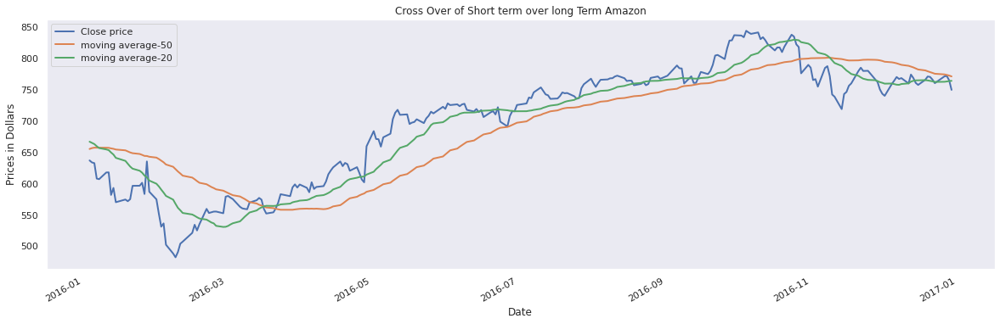

In [72]:
plt.figure(figsize=(20,6))
amazon_cross['close'].plot(label="Close price")
amazon_cross['MA-50'].plot(label="moving average-50")
amazon_cross['MA-20'].plot(label="moving average-20")
plt.title("Cross Over of Short term over long Term Amazon")
plt.xlabel('Date')
plt.ylabel('Prices in Dollars')
plt.legend()
plt.show()



In [73]:
apple_cross.head(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position
date,,,,,,,,,,,,,,,,
2016-01-04,AMZN,656.289978,636.989990,627.510010,657.719971,9314500.0,640.739990,11.928722,666.938170,690.795615,643.080726,6.113013e+09,655.335602,666.972006,1.0,0.0
2016-01-05,AMZN,646.859985,633.789978,627.650024,646.909973,5822600.0,636.116658,13.661357,665.263669,692.586384,637.940954,3.766407e+09,656.733202,665.029504,1.0,0.0
2016-01-06,AMZN,622.000000,632.650024,620.309998,639.789978,5329200.0,630.916667,15.540708,663.379668,694.461084,632.298252,3.314762e+09,657.405602,663.170505,1.0,0.0
2016-01-07,AMZN,621.799988,607.940002,605.210022,630.000000,7074900.0,614.383341,18.684169,660.480336,697.848674,623.111997,4.399173e+09,657.392202,659.701004,1.0,0.0


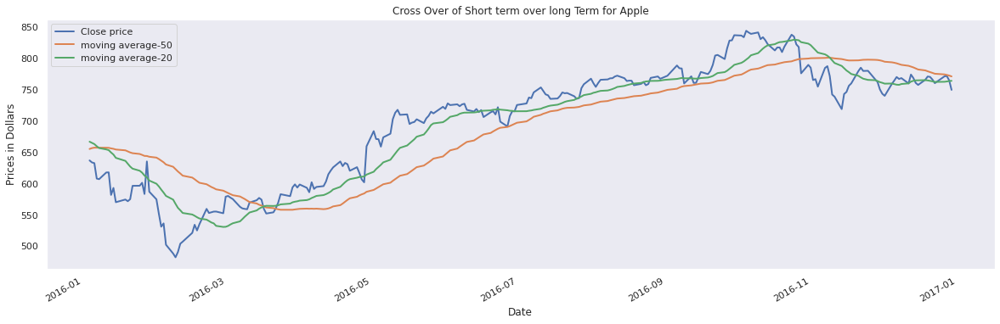

In [74]:
plt.figure(figsize=(20,6))
apple_cross['close'].plot(label="Close price")
apple_cross['MA-50'].plot(label="moving average-50")
apple_cross['MA-20'].plot(label="moving average-20")
plt.title("Cross Over of Short term over long Term for Apple")
plt.xlabel('Date')
plt.ylabel('Prices in Dollars')
plt.legend()
plt.show()


In [75]:
microsoft_cross.head(2)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20
date,,,,,,,,,,,,,,
2016-01-04,MSFT,54.32,54.799999,53.389999,54.799999,53778000.0,54.329999,0.587482,55.399,56.573963,54.224036,2.921221e+09,54.4006,55.444
2016-01-05,MSFT,54.93,55.049999,54.540001,55.389999,34079700.0,54.993333,0.594064,55.378,56.566127,54.189872,1.871998e+09,54.5410,55.401


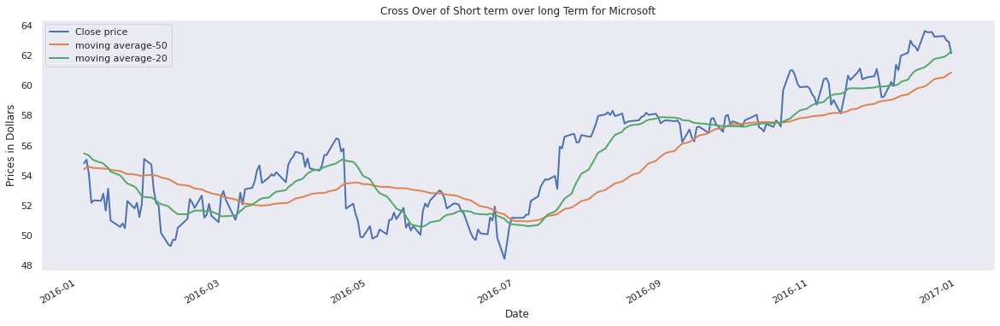

In [76]:
plt.figure(figsize=(20,6))
microsoft_cross['close'].plot(label="Close price")
microsoft_cross['MA-50'].plot(label="moving average-50")
microsoft_cross['MA-20'].plot(label="moving average-20")
plt.title("Cross Over of Short term over long Term for Microsoft")
plt.xlabel('Date')
plt.ylabel('Prices in Dollars')
plt.legend()
plt.show()


# Insight
##### The Cross Over Strategy can be used to predict when to buy or sell a particular asset. 
#### Buy = When the Short term MA (MA-20) is crossing Above the Long Term(MA-50)
#### Sell =  When the Short term MA(MA-20) cross below the Long term(MA-50)

## To get the relationship between the open prices, close Price Percentage of the companies, a new dataframe was formed (tech.company). Same goes with percent close price

In [77]:
tech_company = pd.concat([amazon['open'], apple['open'], microsoft['open']], axis=1)
tech_company.columns = ['Amazon open', "Apple open", "microsoft"]

In [78]:
close_df = pd.concat([amazon['close'], apple['close'], microsoft['close']], axis=1)
close_df.columns = ['Amazon close', "Apple close", "Microsoft close"]

In [79]:
close_df_percent = close_df.pct_change()

In [80]:
close_df_percent

,Amazon close,Apple close,Microsoft close
date,,,
2010-01-04,NaN,NaN,NaN
2010-01-05,0.005900,0.001729,0.000323
2010-01-06,-0.018116,-0.015906,-0.006137
2010-01-07,-0.017013,-0.001849,-0.010400
2010-01-08,0.027077,0.006648,0.006897
...,...,...,...
2016-12-23,-0.007503,0.001978,-0.004878
2016-12-27,0.014213,0.006351,0.000632
2016-12-28,0.000946,-0.004264,-0.004583


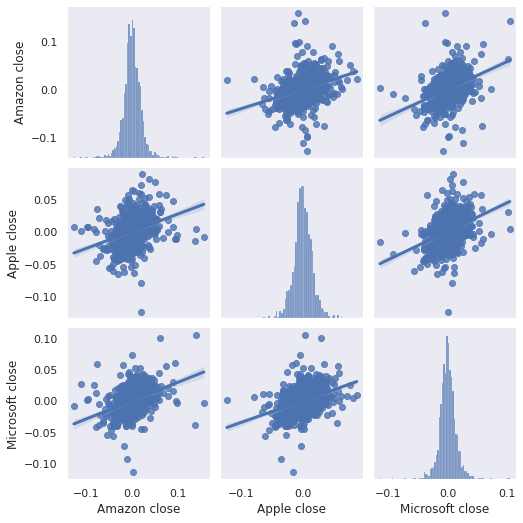

In [81]:
sns.pairplot(close_df_percent,  kind="reg")

# Insight
The Relationship between the the open prices of the assets is positive linear but not perfect 

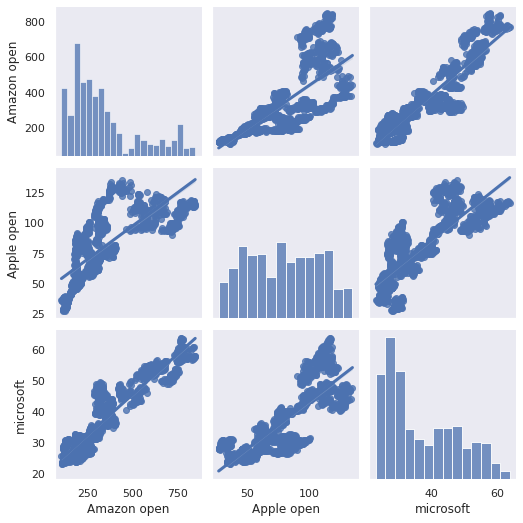

In [82]:
sns.pairplot(tech_company, kind='reg')

The relationship between Microsoft and Amazon is perfectly positively linear

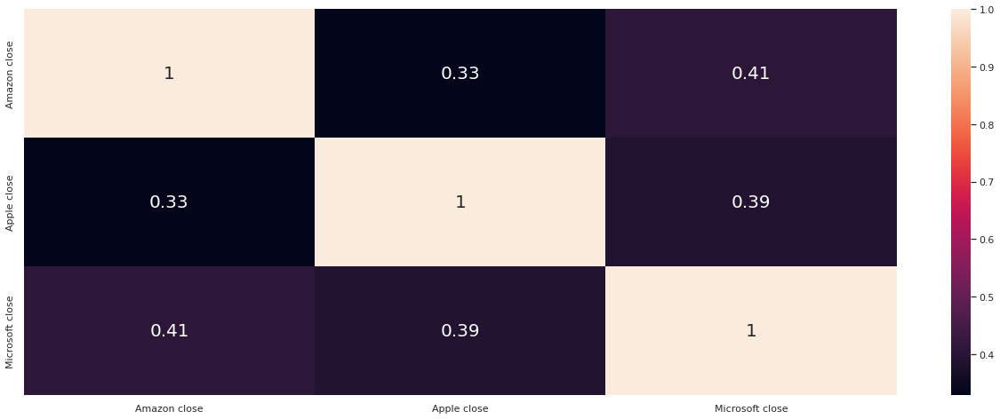

In [83]:
sns.heatmap(close_df_percent.corr(), annot = True)

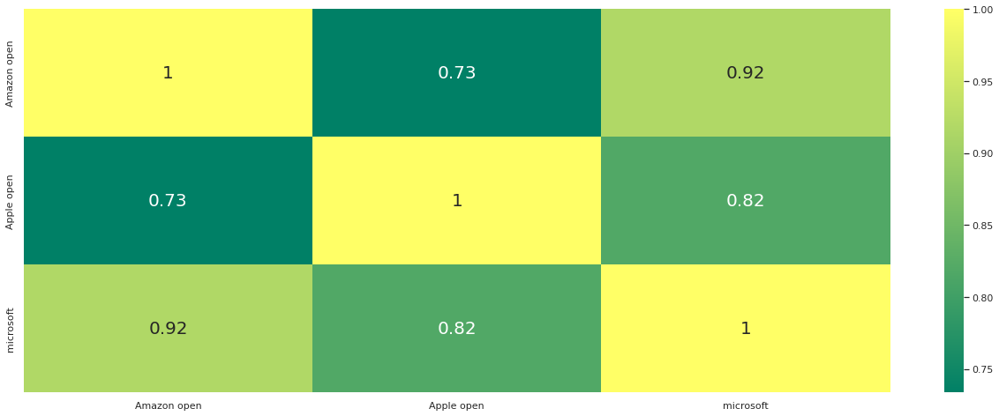

In [84]:
sns.heatmap(tech_company.corr(), annot=True, cmap="summer")

# Financial analysis

## daily percentage change

R_t=  P_t/P_(t-1) -1. This is used to calculate the daily Return of each asset. P(t) = Price at a Particular day while P(t-1) = Price at the previous day. This can be used to Daily Profit or Loss of a Particular asset. A +sign indicates Profit while a negative indicates a loss. The Return was used here to access the risk of investing in each of the stocks

In [85]:
amazon["AMZN Return"] = (amazon['close']/amazon['close'].shift(1))-1

In [86]:
amazon.sample(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position,AMZN Return
date,,,,,,,,,,,,,,,,,
2010-04-27,AMZN,145.550003,142.020004,141.110001,146.440002,8639000.0,143.190002,4.750886,140.716333,150.218106,131.214560,1.257406e+09,132.318800,140.832000,1.0,0.0,-0.034600
2012-09-20,AMZN,260.029999,260.809998,258.000000,260.869995,2913600.0,259.893331,6.515888,252.398500,265.430276,239.366723,7.576234e+08,239.241200,252.617000,1.0,0.0,-0.003325
2015-07-08,AMZN,434.350006,429.700012,428.829987,435.989990,2383100.0,431.506663,4.895217,434.385002,444.175436,424.594568,1.035099e+09,430.275202,434.477003,1.0,0.0,-0.016074
2016-03-01,AMZN,556.289978,579.039978,556.000000,579.250000,5038500.0,571.429993,25.599567,530.330667,581.529800,479.131534,2.802867e+09,586.693600,530.831499,0.0,0.0,0.047998


In [87]:
apple['APPL Return'] = (apple['close']/apple['close'].shift(1))-1

In [88]:
apple.sample(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,APPL Return
date,,,,,,,,,,,,,,,
2014-08-25,AAPL,101.790001,101.540001,101.279999,102.169998,40270000.0,101.663333,2.253953,97.509833,102.017739,93.001927,4.099083e+09,95.393600,97.576500,0.002171
2012-01-10,AAPL,60.844284,60.462856,60.214287,60.857143,64549100.0,60.511429,1.965528,57.315524,61.246580,53.384467,3.927444e+09,56.149886,57.333214,0.003580
2010-08-05,AAPL,37.389999,37.385715,37.221428,37.597141,72274300.0,37.401428,0.718178,36.709214,38.145570,35.272858,2.702336e+09,36.862714,36.725714,-0.004867
2013-03-21,AAPL,64.317146,64.675713,64.300003,65.425713,95813900.0,64.800476,1.436029,62.761905,65.633962,59.889847,6.162477e+09,65.776429,62.742857,0.001438


In [89]:
microsoft['MSFT Return'] = (microsoft['close']/microsoft['close'].shift(1))-1

In [90]:
microsoft.head(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,MSFT Return
date,,,,,,,,,,,,,,,
2010-01-04,MSFT,30.620001,30.950001,30.590000,31.100000,38409100.0,30.880000,NaN,NaN,NaN,NaN,1.176087e+09,NaN,NaN,NaN
2010-01-05,MSFT,30.850000,30.959999,30.639999,31.100000,49749600.0,30.899999,NaN,NaN,NaN,NaN,1.534775e+09,NaN,NaN,0.000323
2010-01-06,MSFT,30.879999,30.770000,30.520000,31.080000,58182400.0,30.790000,NaN,NaN,NaN,NaN,1.796672e+09,NaN,NaN,-0.006137
2010-01-07,MSFT,30.629999,30.450001,30.190001,30.700001,50559700.0,30.446668,NaN,NaN,NaN,NaN,1.548644e+09,NaN,NaN,-0.010400


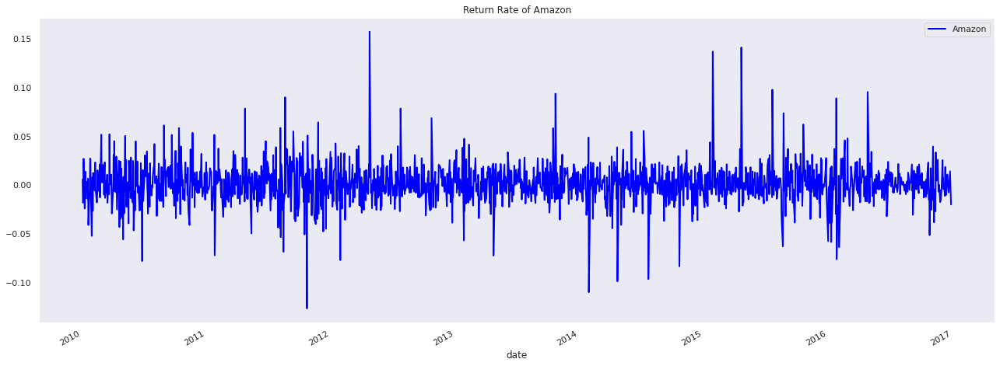

In [91]:
amazon['AMZN Return'].plot(label="Amazon", color="blue")
plt.title("Return Rate of Amazon")
plt.legend()
plt.show()

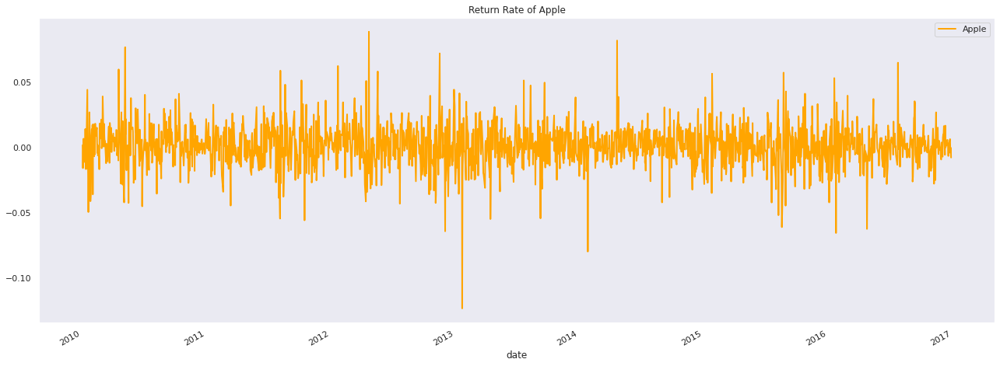

In [92]:
apple['APPL Return'].plot(label="Apple", color="orange")
plt.title("Return Rate of Apple")
plt.legend()
plt.show()

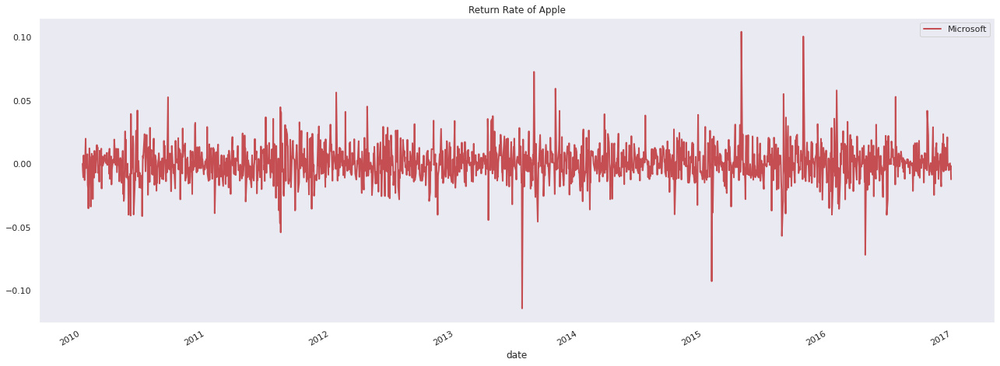

In [93]:
microsoft['MSFT Return'].plot(label="Microsoft", color="r")
plt.title("Return Rate of Apple")
plt.legend()
plt.show()

### The graphs above show the return rate of each asset over the years. Looking at the chart, it can be deduced that amazon has the best profit return among the three assets

In [94]:
amazon_return = amazon[['AMZN Return']]
apple_return = apple[['APPL Return']]
microsoft_return = microsoft[['MSFT Return']]

In [95]:
amazon_return

,AMZN Return
date,
2010-01-04,NaN
2010-01-05,0.005900
2010-01-06,-0.018116
2010-01-07,-0.017013
2010-01-08,0.027077
...,...
2016-12-23,-0.007503
2016-12-27,0.014213
2016-12-28,0.000946


In [96]:
return_df = pd.concat([amazon_return, apple_return, microsoft_return], axis=0)

In [97]:
return_df.sample(4)

,AMZN Return,APPL Return,MSFT Return
date,,,
2014-03-20,NaN,NaN,0.026993
2014-07-18,NaN,NaN,0.003593
2012-05-08,NaN,-0.002283,NaN
2012-02-17,0.014283,NaN,NaN


In [98]:
annualized_return = return_df.mean()*253

In [99]:
annualized_return


AMZN Return    0.299973
APPL Return    0.225967
MSFT Return    0.127129
dtype: float64

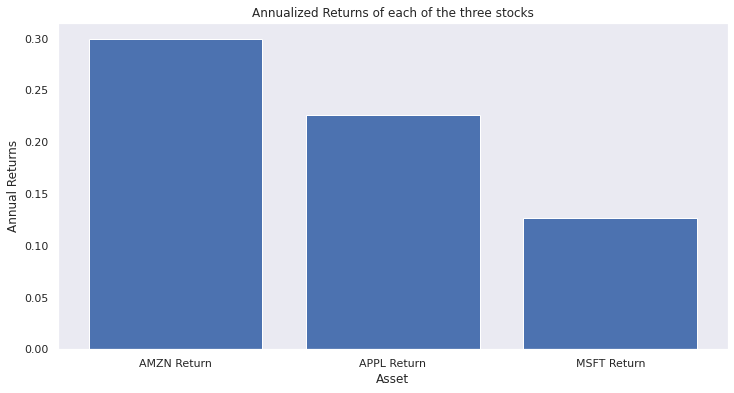

In [100]:
plt.figure(figsize=(12,6))
plt.bar(annualized_return.index, annualized_return)
plt.xlabel('Asset')
plt.ylabel('Annual Returns')
plt.title('Annualized Returns of each of the three stocks')
plt.show()

##### The chart shows the annualised return of the three assets with Amazon being the best performer

### Volatility

Text(0.5, 1.0, 'Amazon Return distribution to measure the Volatility')

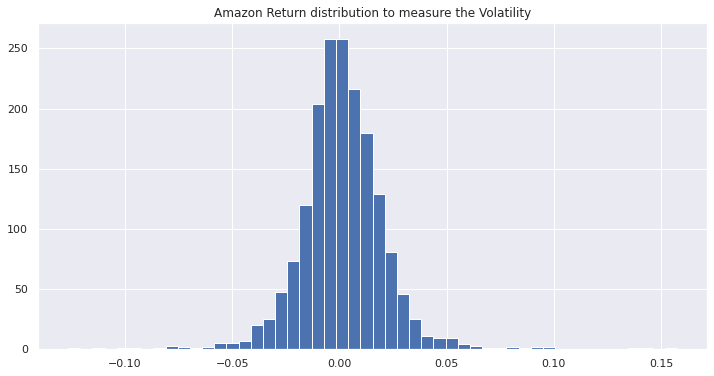

In [101]:
plt.figure(figsize=(12,6))
amazon["AMZN Return"].hist(bins=50)
plt.title("Amazon Return distribution to measure the Volatility")

Text(0.5, 1.0, 'Apple return distribution to measure the volatility')

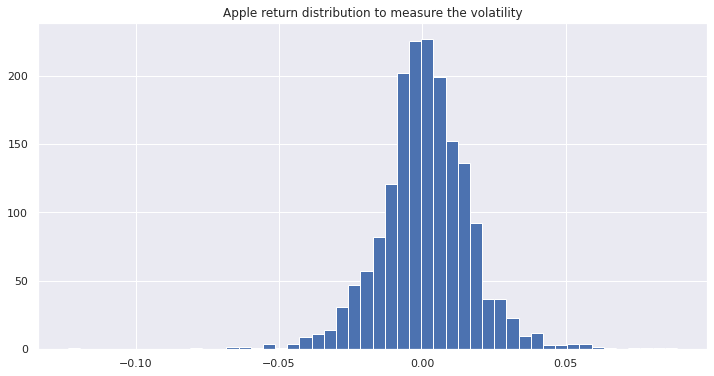

In [102]:
plt.figure(figsize=(12,6))
apple["APPL Return"].hist(bins=50)
plt.title("Apple return distribution to measure the volatility")


Text(0.5, 1.0, 'Microsoft return distribution to measure the volatility')

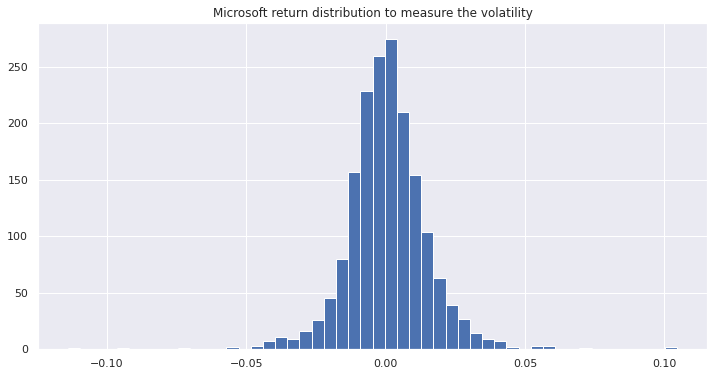

In [103]:
plt.figure(figsize=(12,6))
microsoft["MSFT Return"].hist(bins=50)
plt.title("Microsoft return distribution to measure the volatility")

### Comparing the volatility of the three

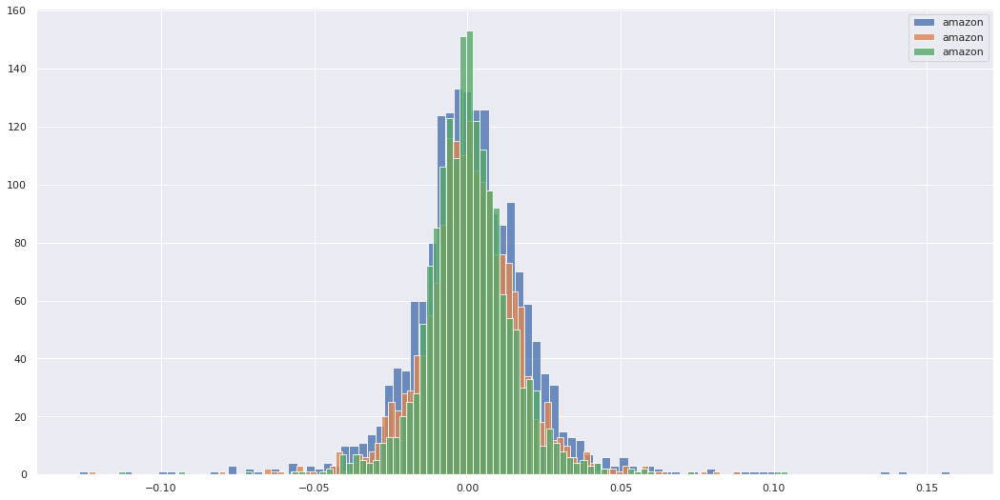

In [104]:
plt.figure(figsize=(18,9))
amazon["AMZN Return"].hist(bins=100, label="amazon", alpha=0.8)
apple["APPL Return"].hist(bins=100, label="amazon", alpha=0.8)
microsoft["MSFT Return"].hist(bins=100, label="amazon", alpha=0.8)
plt.legend()

The Chart above shows an almost equal spread around the mean. This indicates that they are almost equal in volatility as amazon as most volality. This can be better visualize by the KDE diagrams below. 

### The three companies have very close spread, so there volatility is close.

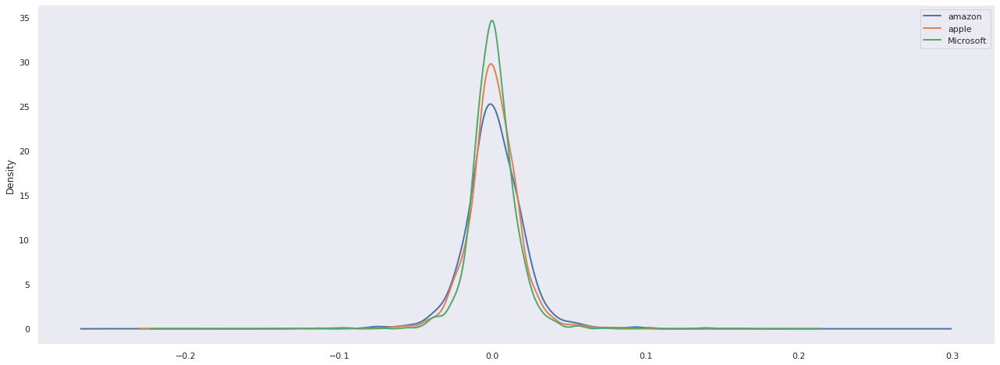

In [105]:
amazon["AMZN Return"].plot(kind="kde", label ="amazon")
apple["APPL Return"].plot(kind="kde", label ="apple")
microsoft["MSFT Return"].plot(kind="kde", label ="Microsoft")
plt.legend()

## Cummulative Return

###### I(t) = (1 + r(t))I(t-1).  Cummulative Return helps to keep track on stock changes over a long Period of Time. Unlike Daily Return, it gives back Dividend. It is measures against one dollar. 

In [106]:
amazon["Cummulative Return"] = (1 + amazon["AMZN Return"]).cumprod()
apple["Cummulative Return"] = (1 + apple["APPL Return"]).cumprod()
microsoft["Cummulative Return"] = (1 + microsoft["MSFT Return"]).cumprod()

In [107]:
amazon.head(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position,AMZN Return,Cummulative Return
date,,,,,,,,,,,,,,,,,,
2010-01-04,AMZN,136.250000,133.899994,133.139999,136.610001,7599900.0,134.549998,NaN,NaN,NaN,NaN,1.035486e+09,NaN,NaN,0.0,NaN,NaN,NaN
2010-01-05,AMZN,133.429993,134.690002,131.809998,135.479996,8851900.0,133.993332,NaN,NaN,NaN,NaN,1.181109e+09,NaN,NaN,0.0,0.0,0.005900,1.005900
2010-01-06,AMZN,134.600006,132.250000,131.649994,134.729996,7178800.0,132.876663,NaN,NaN,NaN,NaN,9.662665e+08,NaN,NaN,0.0,0.0,-0.018116,0.987677
2010-01-07,AMZN,132.009995,130.000000,128.800003,132.320007,11030200.0,130.373337,NaN,NaN,NaN,NaN,1.456097e+09,NaN,NaN,0.0,0.0,-0.017013,0.970874


In [108]:
apple.head(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,APPL Return,Cummulative Return
date,,,,,,,,,,,,,,,,
2010-01-04,AAPL,30.490000,30.572857,30.340000,30.642857,123432400.0,30.518571,NaN,NaN,NaN,NaN,3.763454e+09,NaN,NaN,NaN,NaN
2010-01-05,AAPL,30.657143,30.625713,30.464285,30.798571,150476200.0,30.629523,NaN,NaN,NaN,NaN,4.613170e+09,NaN,NaN,0.001729,1.001729
2010-01-06,AAPL,30.625713,30.138571,30.107143,30.747143,138040000.0,30.330952,NaN,NaN,NaN,NaN,4.227573e+09,NaN,NaN,-0.015906,0.985795
2010-01-07,AAPL,30.250000,30.082857,29.864286,30.285715,119282800.0,30.077620,NaN,NaN,NaN,NaN,3.608305e+09,NaN,NaN,-0.001849,0.983973


In [109]:
microsoft.head()

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,MSFT Return,Cummulative Return
date,,,,,,,,,,,,,,,,
2010-01-04,MSFT,30.620001,30.950001,30.590000,31.100000,38409100.0,30.880000,NaN,NaN,NaN,NaN,1.176087e+09,NaN,NaN,NaN,NaN
2010-01-05,MSFT,30.850000,30.959999,30.639999,31.100000,49749600.0,30.899999,NaN,NaN,NaN,NaN,1.534775e+09,NaN,NaN,0.000323,1.000323
2010-01-06,MSFT,30.879999,30.770000,30.520000,31.080000,58182400.0,30.790000,NaN,NaN,NaN,NaN,1.796672e+09,NaN,NaN,-0.006137,0.994184
2010-01-07,MSFT,30.629999,30.450001,30.190001,30.700001,50559700.0,30.446668,NaN,NaN,NaN,NaN,1.548644e+09,NaN,NaN,-0.010400,0.983845
2010-01-08,MSFT,30.280001,30.660000,30.240000,30.879999,51197400.0,30.593333,NaN,NaN,NaN,NaN,1.550257e+09,NaN,NaN,0.006897,0.990630


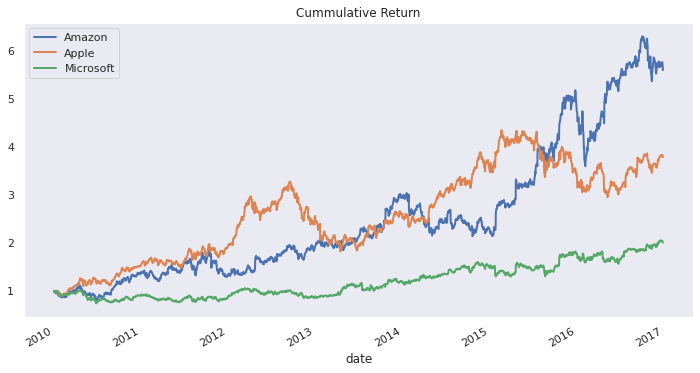

In [110]:
plt.figure(figsize=(12,6))
amazon['Cummulative Return'].plot(label="Amazon")
apple["Cummulative Return"].plot(label="Apple")
microsoft["Cummulative Return"].plot(label="Microsoft")
plt.legend()
plt.title("Cummulative Return")
plt.show()

 In overall sense of manner, amazon has a better cummulative return because $1 invested in Amazon back in 2010 is equivalent to $5.5 in 2017.

# ONE DAY AHEAD PREDICTION FOR AMAZON

In [111]:
df = amazon.filter(['close'])
df1 = df.values

# AVERAGE
### Using The Average value Of The previous outcome

In [112]:
import math
from sklearn.metrics import mean_squared_error as mse
train = int((len(df))*0.7)
test = len(df) - train

training_data = df.iloc[:train]
y_test = df.iloc[train:]

y_pred = pd.Series(np.array(np.repeat(training_data.mean(), test)), index = y_test.index)
print('Root mean Square = ', np.sqrt(mse(y_test,y_pred)))

Root mean Square =  374.8680828047358


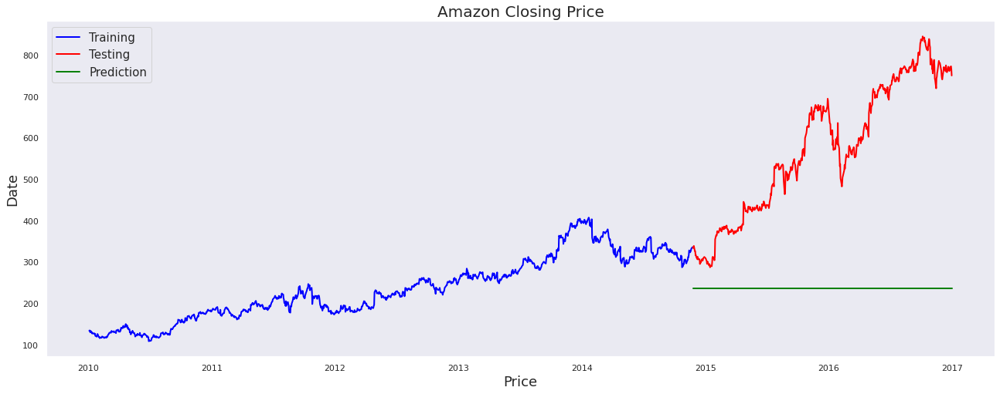

Root mean Square =  374.8680828047358


In [113]:
plt.plot(training_data, label = "Training", c = 'blue')
plt.plot(y_test,label = "Testing", c = 'red' )
plt.plot(y_pred,label = "Prediction", c = 'green')
plt.title("Amazon Closing Price", fontsize = 20)
plt.xlabel('Price', fontsize = 18)
plt.ylabel('Date', fontsize = 18)
plt.legend(loc ='best', fontsize = 15)
plt.show()
print('Root mean Square = ', np.sqrt(mse(y_test,y_pred)))

# INSIGHT
#### The average of the previous observation method fails to give a better result. The predicted line is far from the test line and it yields a very big root mean square.

### LSTM Recurrent Neural Networks

In [114]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
from sklearn.metrics import mean_squared_error as mse
from sklearn.preprocessing import MinMaxScaler

# FEATURE ENGINEERING

In [115]:
#scaling of data
scale = MinMaxScaler()
scale_data=scale.fit_transform(df1)
scale_data

array([[0.03437308],
       [0.03544683],
       [0.03213048],
       ...,
       [0.90182809],
       [0.8923412 ],
       [0.87157324]])

In [116]:
training_len = math.ceil(len(scale_data) * .7)
training_len

1234

In [117]:
# creating a training  and testing data
train = scale_data[0:training_len, :]
train.shape

(1234, 1)

In [118]:
#spliting to X anf y train
## The Time shift = 60
# creating a training  and testing data

train = scale_data[0:training_len, :]
X_train = []
y_train =[]
for i in range(60,len(train)):
    X_train.append(train[i-60:i,0])
    y_train.append(train[i,0])

In [119]:
len(X_train),len(y_train)

(1174, 1174)

### Reshaping the X_train for Neural Network purpose

In [120]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_train= X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_train.shape,y_train.shape

((1174, 60, 1), (1174,))

### LSTM MODEL

In [121]:
model = Sequential()
    
model.add(LSTM(50, input_shape=(X_train.shape[1], 1), return_sequences=True))
model.add(LSTM(50, return_sequences=False))
model.add(Dense(25))
model.add(Dense(1))
    

model.compile(optimizer = 'adam', loss = 'mean_squared_error')
model.fit(X_train,y_train, batch_size = 1,epochs =1)

1174/1174 [==============================] - 35s 27ms/step - loss: 6.1830e-04


In [122]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 60, 50)            10400     
                                                                 
 lstm_1 (LSTM)               (None, 50)                20200     
                                                                 
 dense (Dense)               (None, 25)                1275      
                                                                 
 dense_1 (Dense)             (None, 1)                 26        
                                                                 
Total params: 31,901
Trainable params: 31,901
Non-trainable params: 0
_________________________________________________________________


In [123]:
Model: "sequential"

# PREDICTION

In [124]:
#Testing dataset
#The Time shift = 60
test_data = scale_data[training_len-60:,:]

X_test = []
y_test=df1[training_len:,:] # the real data
for i in range(60,len(test_data)):
    X_test.append(test_data[i-60:i,0])

X_test = np.array(X_test)
y_test = np.array(y_test)
X_test=  np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
X_test.shape,y_test.shape

((528, 60, 1), (528, 1))

In [125]:
y_pred = model.predict(X_test)

In [126]:
# Converting predictions from scaled values to original values
predictions = scale.inverse_transform(y_pred)

In [127]:
print('Root Mean Square = ' , np.sqrt(mse(y_test,predictions)))

Root Mean Square =  37.48044127449686


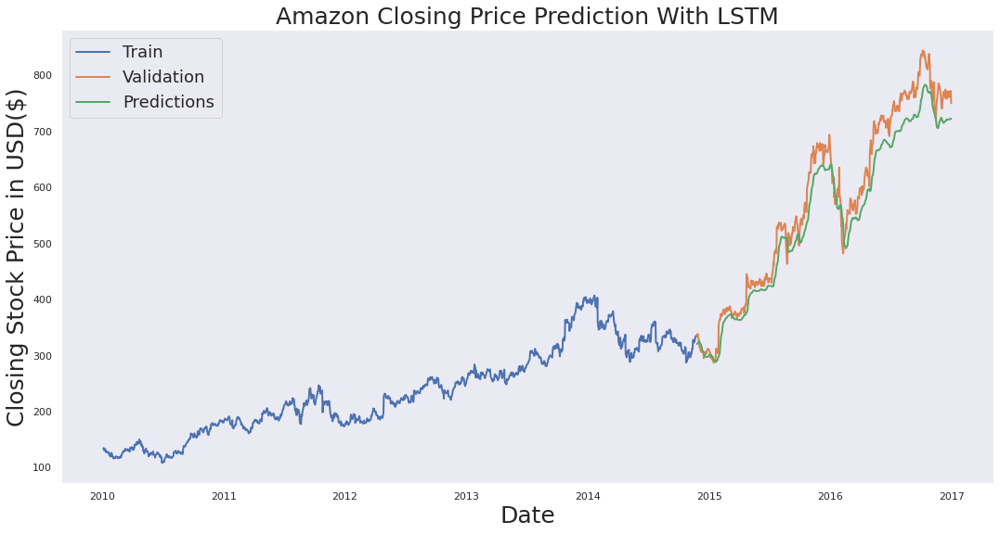

In [128]:
# ploting the model
train = df[:training_len]
valid = df[training_len:]
valid['prediction'] = predictions
plt.figure(figsize = (18,9))
plt.plot(train['close'])
plt.plot(valid[['close', 'prediction']])
plt.xlabel('Date',fontsize = 25)
plt.ylabel('Closing Stock Price in USD($)',fontsize = 25)
plt.legend(['Train', 'Validation', 'Predictions'], fontsize = 18)
plt.title("Amazon Closing Price Prediction With LSTM", fontsize = 25)
plt.show()

# LSTM NEURAL NETWORK tends to work well with the data than the previous method. The predicted line fit the test data line

In [129]:
print("Actual values and Predictions")
valid.head(8)

Actual values and Predictions


,close,prediction
date,,
2014-11-26,333.570007,320.317322
2014-11-28,338.640015,322.120789
2014-12-01,326.000000,323.910309
2014-12-02,326.309998,324.536804
2014-12-03,316.500000,324.471375
2014-12-04,316.929993,323.229340
2014-12-05,312.630005,321.451172
2014-12-08,306.640015,319.169922


# One day ahead prediction

In [130]:
df = apple.filter(['close'])
# the last 60 days
df1 = df[-60:].values

# scaling it
df_scale = scale.fit_transform(df1)

# positioning it into testing data
x_test = []

x_test.append(df_scale)
# to array and reshaping
x_test = np.array(x_test)
x_test = x_test.reshape(x_test.shape[0], x_test.shape[1], 1)
# prediction
pred = model.predict(x_test)
pred_price = scale.inverse_transform(pred)
pred_price

array([[115.952446]], dtype=float32)

# APPLE

In [131]:
#create a new dataset with the close column
apple_close = apple.filter(['close'])
cl_apple = apple.filter(['close']).values
cl_apple

array([[ 30.57285686],
       [ 30.62571329],
       [ 30.13857071],
       ...,
       [116.760002  ],
       [116.730003  ],
       [115.82      ]])

# FEATURE ENGINEERING

In [132]:
scale = MinMaxScaler()
scale_data=scale.fit_transform(cl_apple)
training_len = math.ceil(len(scale_data) * .8)
training_len

1410

In [133]:
# creating a training  and testing data
train = scale_data[0:training_len, :]

train.shape

(1410, 1)

In [134]:
#spliting to X anf y train
## The Time shift = 60

train = scale_data[0:training_len, :]
X_train = []
y_train =[]
for i in range(60,len(train)):
    X_train.append(train[i-60:i,0])
    y_train.append(train[i,0])

In [135]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_train= X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_train.shape,y_train.shape

((1350, 60, 1), (1350,))

 # MODEL

In [136]:
model = Sequential()
    
model.add(LSTM(50, input_shape=(X_train.shape[1], 1), return_sequences=True))
model.add(LSTM(50, return_sequences=False))
model.add(Dense(25))
model.add(Dense(1))
    

model.compile(optimizer = 'adam', loss = 'mean_squared_error')
model.fit(X_train,y_train, batch_size = 1,epochs =1)

1350/1350 [==============================] - 39s 27ms/step - loss: 0.0020


In [137]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (None, 60, 50)            10400     
                                                                 
 lstm_3 (LSTM)               (None, 50)                20200     
                                                                 
 dense_2 (Dense)             (None, 25)                1275      
                                                                 
 dense_3 (Dense)             (None, 1)                 26        
                                                                 
Total params: 31,901
Trainable params: 31,901
Non-trainable params: 0
_________________________________________________________________


# PREDICTION

In [138]:
#Testing dataset
#The Time shift = 60
test_data = scale_data[training_len-60:,:]

X_test = []
y_test=cl_apple[training_len:,:] # the real data
for i in range(60,len(test_data)):
    X_test.append(test_data[i-60:i,0])

X_test = np.array(X_test)
y_test = np.array(y_test)
X_test=  np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
X_test.shape,y_test.shape

((352, 60, 1), (352, 1))

In [139]:
# Converting predictions from scaled values to original values
apple_pred = model.predict(X_test)
predictions = scale.inverse_transform(apple_pred)

In [140]:
print('Root Mean Square = ' , np.sqrt(mse(y_test,predictions)))

Root Mean Square =  4.316244976032102


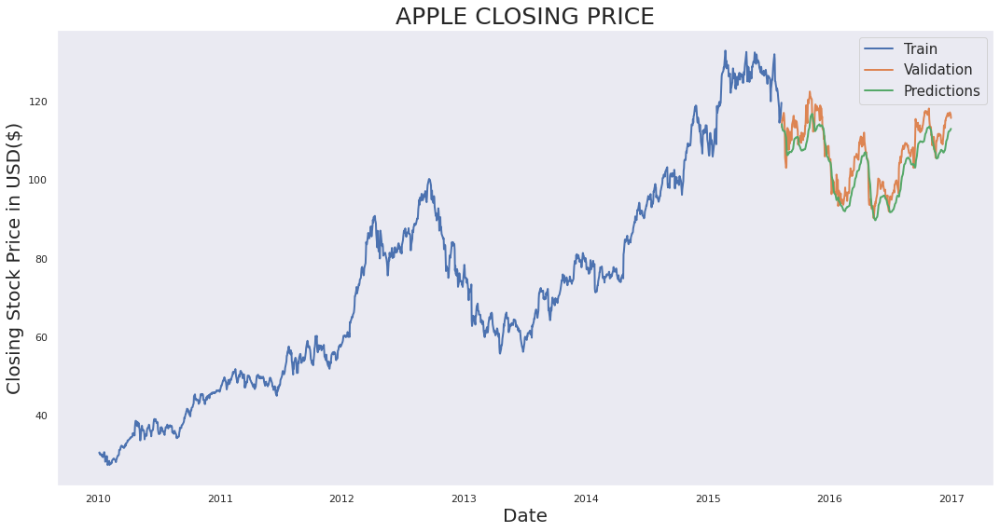

In [141]:
# ploting the model
train = apple_close[:training_len]
valid = apple_close[training_len:]
valid['prediction'] = predictions
plt.figure(figsize = (18,9))
plt.plot(train['close'])
plt.plot(valid[['close', 'prediction']])
plt.xlabel('Date',fontsize = 20)
plt.ylabel('Closing Stock Price in USD($)', fontsize = 20)
plt.legend(['Train', 'Validation', 'Predictions'], fontsize = 15)
plt.title('APPLE CLOSING PRICE', fontsize = 25)
plt.show()

In [142]:
print('Actual values and Predicted values')
valid.head(10)

Actual values and Predicted values


,close,prediction
date,,
2015-08-11,113.489998,114.255341
2015-08-12,115.239998,113.628105
2015-08-13,115.150002,113.126747
2015-08-14,115.959999,112.717621
2015-08-17,117.160004,112.482849
2015-08-18,116.500000,112.480293
2015-08-19,115.010002,112.516853
2015-08-20,112.650002,112.418129
2015-08-21,105.760002,112.025490


# Prediction

In [143]:
# prediction
df = apple.filter(['close'])
# the last 60 days
df1 = df[-60:].values

# scaling it
df_scale = scale.fit_transform(df1)

# positioning it into testing data
x_test = []

x_test.append(df_scale)
# to array and reshaping
x_test = np.array(x_test)
x_test = x_test.reshape(x_test.shape[0], x_test.shape[1], 1)
# prediction
pred = model.predict(x_test)
pred_price = scale.inverse_transform(pred)
print('The following day prediction')
pred_price

The following day prediction


array([[116.15989]], dtype=float32)

# MICROSOFT

In [144]:
#create a new dataset with the close column
microsoft_close = microsoft.filter(['close'])
cl_microsoft = microsoft.filter(['close']).values
cl_microsoft

array([[30.950001],
       [30.959999],
       [30.77    ],
       ...,
       [62.990002],
       [62.900002],
       [62.139999]])

# FEATURE ENGINEERING

In [145]:
scale = MinMaxScaler()
scale_data=scale.fit_transform(cl_microsoft)
training_len = math.ceil(len(scale_data) * .7)
training_len
# creating a training  and testing data
train = scale_data[0:training_len, :]

train.shape


(1234, 1)

In [146]:
#spliting to X anf y train
## The Time shift = 60

train = scale_data[0:training_len, :]
X_train = []
y_train =[]
for i in range(60,len(train)):
    X_train.append(train[i-60:i,0])
    y_train.append(train[i,0])
X_train = np.array(X_train)
y_train = np.array(y_train)
X_train= X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_train.shape,y_train.shape

((1174, 60, 1), (1174,))

## Model

In [147]:
model = Sequential()
    
model.add(LSTM(50, input_shape=(X_train.shape[1], 1), return_sequences=True))
model.add(LSTM(50, return_sequences=False))
model.add(Dense(25))
model.add(Dense(1))
    

model.compile(optimizer = 'adam', loss = 'mean_squared_error')
model.fit(X_train,y_train, batch_size = 1,epochs =5)

Epoch 1/5
1174/1174 [==============================] - 35s 28ms/step - loss: 0.0011
Epoch 2/5
1174/1174 [==============================] - 32s 27ms/step - loss: 5.2642e-04
Epoch 3/5
1174/1174 [==============================] - 32s 27ms/step - loss: 4.1098e-04
Epoch 4/5
1174/1174 [==============================] - 32s 27ms/step - loss: 3.2042e-04
Epoch 5/5
1174/1174 [==============================] - 32s 27ms/step - loss: 2.7902e-04


### Prediction

In [148]:
#Testing dataset
#The Time shift = 60
test_data = scale_data[training_len-60:,:]

X_test = []
y_test=cl_microsoft[training_len:,:] # the real data
for i in range(60,len(test_data)):
    X_test.append(test_data[i-60:i,0])

X_test = np.array(X_test)
y_test = np.array(y_test)
X_test=  np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
X_test.shape,y_test.shape

((528, 60, 1), (528, 1))

In [149]:
# Converting predictions from scaled values to original values
pred = model.predict(X_test)
predictions = scale.inverse_transform(pred)

In [150]:
print('Root Mean Square = ' , np.sqrt(mse(y_test,predictions)))

Root Mean Square =  0.9775001934902096


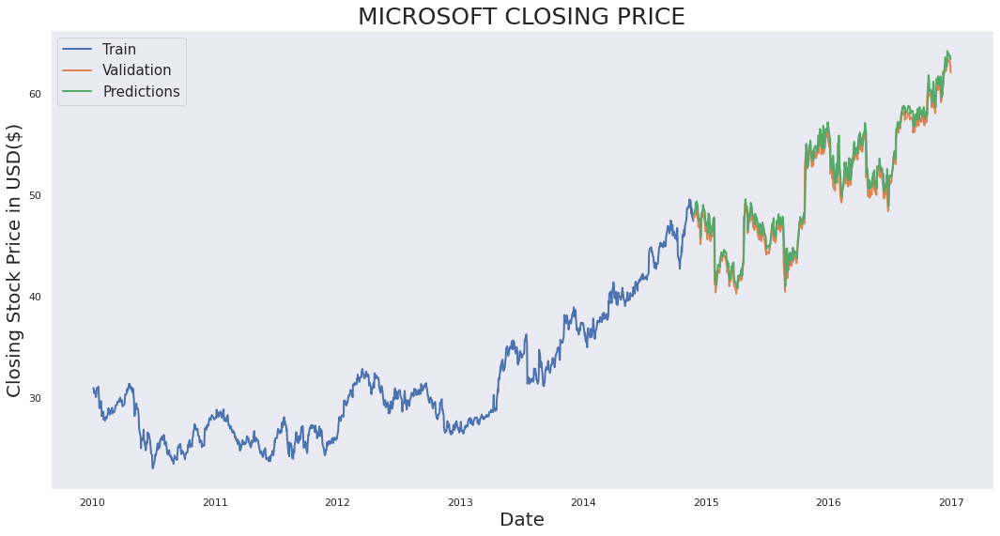

In [151]:
# ploting the model
train = microsoft_close[:training_len]
valid = microsoft_close[training_len:]
valid['prediction'] = predictions
plt.figure(figsize = (18,9))
plt.plot(train['close'])
plt.plot(valid[['close', 'prediction']])
plt.xlabel('Date',fontsize = 20)
plt.ylabel('Closing Stock Price in USD($)', fontsize = 20)
plt.legend(['Train', 'Validation', 'Predictions'], fontsize = 15)
plt.title('MICROSOFT CLOSING PRICE',fontsize = 25)
plt.show()

In [152]:
print('Actual and Predicted values')
valid.head(10)

Actual and Predicted values


,close,prediction
date,,
2014-11-26,47.750000,48.043415
2014-11-28,47.810001,48.357582
2014-12-01,48.619999,48.458664
2014-12-02,48.459999,49.268997
2014-12-03,48.080002,49.135708
2014-12-04,48.840000,48.697010
2014-12-05,48.419998,49.416897
2014-12-08,47.700001,49.042324
2014-12-09,47.590000,48.275665


### One day ahead prediction

In [153]:
df = microsoft.filter(['close'])
# the last 60 days
df1 = df[-60:].values

# scaling it
df_scale = scale.fit_transform(df1)

# positioning it into testing data
x_test = []

x_test.append(df_scale)
# to array and reshaping
x_test = np.array(x_test)
x_test = x_test.reshape(x_test.shape[0], x_test.shape[1], 1)
# prediction
pred = model.predict(x_test)
pred_price = scale.inverse_transform(pred)
pred_price

array([[62.14683]], dtype=float32)

### LSTM was adopted because it gives a better result than all other models